<a href="https://colab.research.google.com/github/DEEPLEARNINGTP/ClassificationDiabetes-NN/blob/main/TP_APP_FILTRE%20_CONVOLUTION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Created a dummy image: ./test_image.jpg
Loaded gray image type: gray
Loaded RGB image type: rgb
Applying filters...
Filtered images saved to 'filtered_images' directory.
Displaying results...


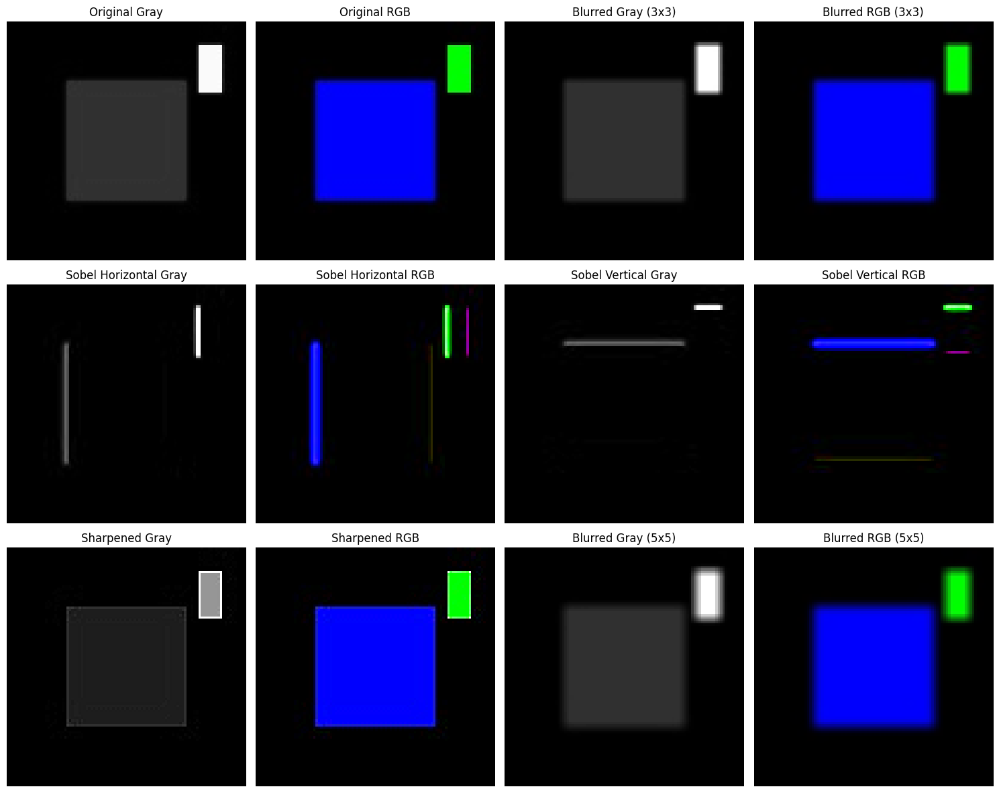

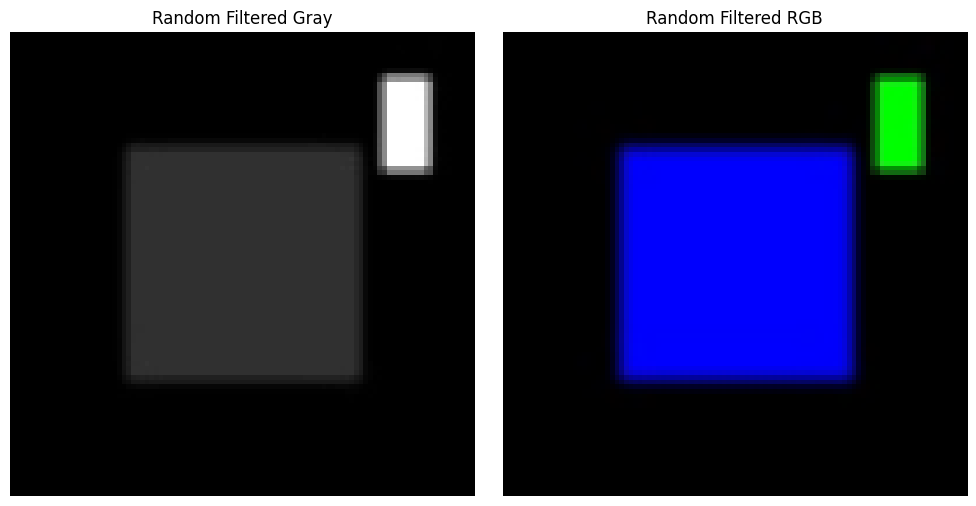

In [ ]:
import numpy as np # cite: 57
import cv2 # cite: 57
import matplotlib.pyplot as plt # Needed for displaying images
import os # For automating path tasks, as suggested in the TODO

# 1. Define the convolution function
# This function applies a given kernel to an image.
def apply_convolution(image, kernel): # cite: 57, 66
    # Assertions to validate inputs
    assert isinstance(image, np.ndarray), "L'image doit être un tableau NumPy"
    assert isinstance(kernel, np.ndarray), "Le noyau doit être un tableau NumPy"
    assert len(kernel.shape) == 2, "Le noyau doit être une matrice 2D"
    assert kernel.shape[0] == kernel.shape[1], "Le noyau doit être carré"
    assert kernel.shape[0] % 2 == 1, "Le noyau doit avoir une taille impaire"
    assert len(image.shape) in [2, 3], "L'image doit être en niveaux de gris (2D) ou RGB (3D)"

    if len(image.shape) == 3: # Image RGB
        assert image.shape[2] == 3, "L'image RGB doit avoir 3 canaux"
        height, width, channels = image.shape # cite: 67
        output = np.zeros_like(image, dtype=np.float32) # cite: 57, 67
        for c in range(channels): # cite: 57, 67
            output[:, :, c] = convolve_channel(image[:, :, c], kernel) # cite: 57, 67
    else: # Image grise
        output = convolve_channel(image, kernel) # cite: 57, 67

    # Normalize to avoid out-of-range values [0, 255]
    return np.clip(output, 0, 255).astype(np.uint8) # cite: 57

# Helper function to convolve a single channel
def convolve_channel(image_channel, kernel): # cite: 58
    k_height, k_width = kernel.shape
    pad_h = k_height // 2
    pad_w = k_width // 2

    # TODO: Modify padding parameters based on expected results
    # np.pad documentation states that padding can be more flexible.
    # For now, using 'constant' mode with 0 for simplicity.
    padded_image = np.pad(image_channel, ((pad_h, pad_h), (pad_w, pad_w)), mode='constant') # cite: 58

    output = np.zeros_like(image_channel, dtype=np.float32) # cite: 58

    for i in range(image_channel.shape[0]): # cite: 58
        for j in range(image_channel.shape[1]): # cite: 58
            # The original snippet had a fixed 3x3 kernel assumption in the sum,
            # which needs to be generalized for any kernel size.
            output[i, j] = np.sum(padded_image[i:i+k_height, j:j+k_width] * kernel) # Modified to use k_height and k_width for general kernel size
    return output # cite: 58

# 2. Define standard kernels
# Blur kernel (mean)
kernel_blur = (1/9) * np.array([[1, 1, 1],
                                 [1, 1, 1],
                                 [1, 1, 1]])

# Sobel Horizontal kernel
kernel_sobel_h = np.array([[-1, 0, 1],
                           [-2, 0, 2],
                           [-1, 0, 1]])

# Sobel Vertical kernel
kernel_sobel_v = np.array([[-1, -2, -1],
                           [0, 0, 0],
                           [1, 2, 1]])

# Example of another kernel from Wikipedia (Sharpen)
# https://en.wikipedia.org/wiki/Kernel_(image_processing)
kernel_sharpen = np.array([[0, -1, 0],
                           [-1, 5, -1],
                           [0, -1, 0]])

# Example of a 5x5 blur kernel (as suggested in the "Rappel" section)
kernel_blur_5x5 = (1/25) * np.ones((5, 5))

# Create a new random filter (as suggested in the "Rappel" section)
# For a random filter, we can generate a random 3x3 matrix.
# Normalization is often applied to random kernels to prevent extreme brightness changes.
kernel_random = np.random.rand(3, 3)
kernel_random = kernel_random / np.sum(kernel_random) if np.sum(kernel_random) != 0 else kernel_random


# 3. Image Loading Function
# TODO1: Improve this script to automate whether it's a grayscale or RGB image.
# TODO2: Add assertions to test if it's a grayscale or RGB image.
def image_load(image_path, channel=None): # channel=None allows for automation
    if not os.path.exists(image_path):
        raise FileNotFoundError(f"Image not found at: {image_path}")

    # Try to read as color first
    img_color = cv2.imread(image_path, cv2.IMREAD_COLOR)
    if img_color is None:
        raise ValueError(f"Error: Could not load image from {image_path}")

    # Check if the image has 3 channels (implying it was loaded as color)
    if len(img_color.shape) == 3 and img_color.shape[2] == 3:
        is_color_image = True
    else:
        is_color_image = False # It might be a grayscale image saved as 3 channels (e.g., all channels same)

    if channel == 1: # Explicitly request grayscale
        gray_image = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
        return gray_image, "gray"
    elif channel == 3: # Explicitly request RGB
        rgb_image = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB) # Convert BGR to RGB
        return rgb_image, "rgb"
    else: # Automate: determine based on image content
        if is_color_image:
            # Check if all channels are identical (implies grayscale visually)
            if np.all(img_color[:,:,0] == img_color[:,:,1]) and np.all(img_color[:,:,0] == img_color[:,:,2]):
                gray_image = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
                return gray_image, "gray"
            else:
                rgb_image = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)
                return rgb_image, "rgb"
        else: # Image was likely grayscale from the start
            gray_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
            if gray_image is None:
                 raise ValueError(f"Error: Could not load image as grayscale from {image_path}")
            return gray_image, "gray"


# Main execution block
if __name__ == "__main__":
    # Ensure you have an image named 'image.jpg' or change the path
    # You can use os to automate this task, for example, iterating through a directory.
    image_directory = './' # Current directory
    image_filename = 'test_image.jpg' # Replace with your image file name
    image_path = os.path.join(image_directory, image_filename)

    # Create a dummy image for testing if 'test_image.jpg' doesn't exist
    if not os.path.exists(image_path):
        dummy_image = np.zeros((100, 100, 3), dtype=np.uint8)
        dummy_image[25:75, 25:75] = [255, 0, 0] # Red square
        dummy_image[10:30, 80:90] = [0, 255, 0] # Green rectangle
        cv2.imwrite(image_path, dummy_image)
        print(f"Created a dummy image: {image_path}")

    # Load the image
    try:
        original_image_gray, type_gray = image_load(image_path, channel=1)
        original_image_rgb, type_rgb = image_load(image_path, channel=3)
    except (FileNotFoundError, ValueError) as e:
        print(e)
        print("Please ensure 'test_image.jpg' exists or adjust the image_path variable.")
        exit()

    print(f"Loaded gray image type: {type_gray}")
    print(f"Loaded RGB image type: {type_rgb}")

    # Apply filters
    print("Applying filters...")
    # Grayscale images
    blurred_gray = apply_convolution(original_image_gray, kernel_blur)
    sobel_h_gray = apply_convolution(original_image_gray, kernel_sobel_h)
    sobel_v_gray = apply_convolution(original_image_gray, kernel_sobel_v)
    sharpened_gray = apply_convolution(original_image_gray, kernel_sharpen)
    blurred_5x5_gray = apply_convolution(original_image_gray, kernel_blur_5x5)
    random_filtered_gray = apply_convolution(original_image_gray, kernel_random)

    # RGB images
    blurred_rgb = apply_convolution(original_image_rgb, kernel_blur)
    sobel_h_rgb = apply_convolution(original_image_rgb, kernel_sobel_h)
    sobel_v_rgb = apply_convolution(original_image_rgb, kernel_sobel_v)
    sharpened_rgb = apply_convolution(original_image_rgb, kernel_sharpen)
    blurred_5x5_rgb = apply_convolution(original_image_rgb, kernel_blur_5x5)
    random_filtered_rgb = apply_convolution(original_image_rgb, kernel_random)


    # Save results (as suggested in the document, page 3, lines 24-29 in a similar context)
    # Ensure output directory exists
    output_dir = 'filtered_images'
    os.makedirs(output_dir, exist_ok=True)

    cv2.imwrite(os.path.join(output_dir, 'blurred_gray.jpg'), blurred_gray)
    cv2.imwrite(os.path.join(output_dir, 'sobel_h_gray.jpg'), sobel_h_gray)
    cv2.imwrite(os.path.join(output_dir, 'sobel_v_gray.jpg'), sobel_v_gray)
    cv2.imwrite(os.path.join(output_dir, 'sharpened_gray.jpg'), sharpened_gray)
    cv2.imwrite(os.path.join(output_dir, 'blurred_5x5_gray.jpg'), blurred_5x5_gray)
    cv2.imwrite(os.path.join(output_dir, 'random_filtered_gray.jpg'), random_filtered_gray)

    # For RGB images, OpenCV saves in BGR, so convert back before saving
    cv2.imwrite(os.path.join(output_dir, 'blurred_rgb.jpg'), cv2.cvtColor(blurred_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'sobel_h_rgb.jpg'), cv2.cvtColor(sobel_h_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'sobel_v_rgb.jpg'), cv2.cvtColor(sobel_v_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'sharpened_rgb.jpg'), cv2.cvtColor(sharpened_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'blurred_5x5_rgb.jpg'), cv2.cvtColor(blurred_5x5_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'random_filtered_rgb.jpg'), cv2.cvtColor(random_filtered_rgb, cv2.COLOR_RGB2BGR))

    print(f"Filtered images saved to '{output_dir}' directory.")


    # Display results
    print("Displaying results...")
    fig, axes = plt.subplots(3, 4, figsize=(15, 12))
    ax = axes.ravel()

    # Original Images
    ax[0].imshow(original_image_gray, cmap='gray')
    ax[0].set_title('Original Gray')
    ax[0].axis('off')

    ax[1].imshow(original_image_rgb)
    ax[1].set_title('Original RGB')
    ax[1].axis('off')

    # Blurred Images
    ax[2].imshow(blurred_gray, cmap='gray')
    ax[2].set_title('Blurred Gray (3x3)')
    ax[2].axis('off')

    ax[3].imshow(blurred_rgb)
    ax[3].set_title('Blurred RGB (3x3)')
    ax[3].axis('off')

    # Sobel Horizontal
    ax[4].imshow(sobel_h_gray, cmap='gray')
    ax[4].set_title('Sobel Horizontal Gray')
    ax[4].axis('off')

    ax[5].imshow(sobel_h_rgb)
    ax[5].set_title('Sobel Horizontal RGB')
    ax[5].axis('off')

    # Sobel Vertical
    ax[6].imshow(sobel_v_gray, cmap='gray')
    ax[6].set_title('Sobel Vertical Gray')
    ax[6].axis('off')

    ax[7].imshow(sobel_v_rgb)
    ax[7].set_title('Sobel Vertical RGB')
    ax[7].axis('off')

    # Sharpened
    ax[8].imshow(sharpened_gray, cmap='gray')
    ax[8].set_title('Sharpened Gray')
    ax[8].axis('off')

    ax[9].imshow(sharpened_rgb)
    ax[9].set_title('Sharpened RGB')
    ax[9].axis('off')

    # 5x5 Blur
    ax[10].imshow(blurred_5x5_gray, cmap='gray')
    ax[10].set_title('Blurred Gray (5x5)')
    ax[10].axis('off')

    ax[11].imshow(blurred_5x5_rgb)
    ax[11].set_title('Blurred RGB (5x5)')
    ax[11].axis('off')

    plt.tight_layout()
    plt.show()

    # Display Random Filtered Images separately if needed, or add more subplots
    fig_random, axes_random = plt.subplots(1, 2, figsize=(10, 5))
    axes_random[0].imshow(random_filtered_gray, cmap='gray')
    axes_random[0].set_title('Random Filtered Gray')
    axes_random[0].axis('off')

    axes_random[1].imshow(random_filtered_rgb)
    axes_random[1].set_title('Random Filtered RGB')
    axes_random[1].axis('off')

    plt.tight_layout()
    plt.show()

Loaded gray image type: gray
Loaded RGB image type: rgb
Applying filters...
Filtered images saved to 'filtered_images_pepper' directory.
Displaying results...


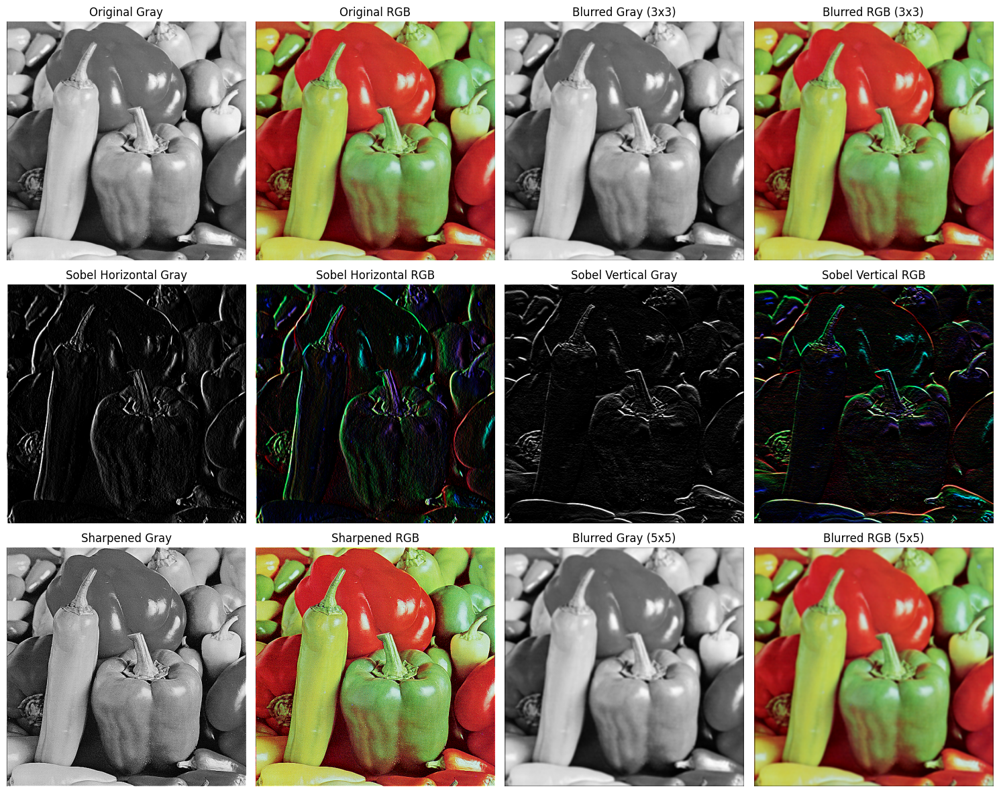

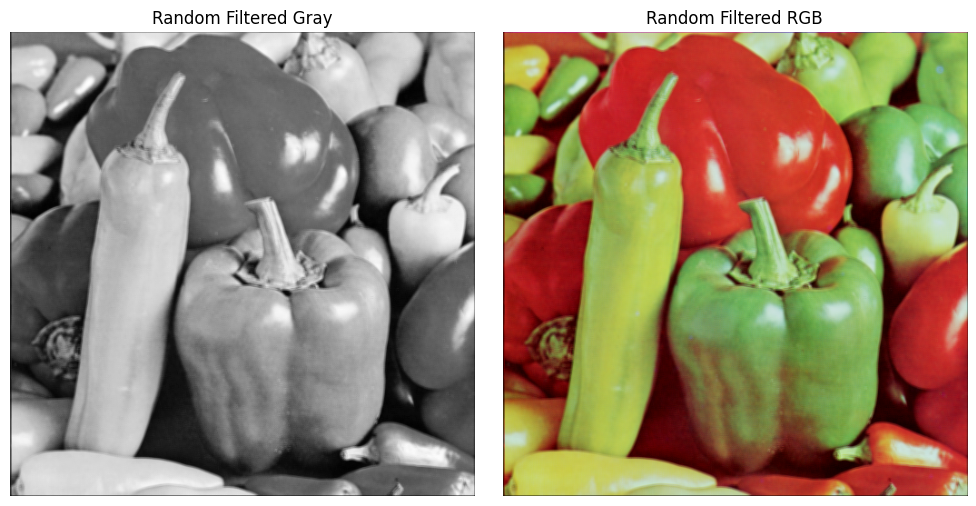

In [ ]:

import matplotlib.pyplot as plt
if __name__ == "__main__":
    # Ensure you have an image named 'pepper.ppm' uploaded to your Colab session
    image_filename = 'pepper.ppm'
    image_directory = './' # Current directory where the file is uploaded
    image_path = os.path.join(image_directory, image_filename)

    # Check if the uploaded file exists
    if not os.path.exists(image_path):
        print(f"Error: The file '{image_filename}' was not found.")
        print("Please upload 'pepper.ppm' to your Colab session.")
        exit() # Exit if the file is not found

    # Load the image
    try:
        # Attempt to load the image explicitly as color (PPM format is typically color)
        original_image_rgb, type_rgb = image_load(image_path, channel=3)

        # If you also need a grayscale version for comparison/processing:
        # Load as grayscale, but keep the RGB load as the primary one based on PPM
        original_image_gray, type_gray = image_load(image_path, channel=1)


    except (FileNotFoundError, ValueError) as e:
        print(e)
        print(f"Could not load image from {image_path}. Please check the file.")
        exit()

    print(f"Loaded gray image type: {type_gray}")
    print(f"Loaded RGB image type: {type_rgb}")

    # Apply filters
    print("Applying filters...")
    # We will apply filters primarily to the RGB image as it's the loaded format,
    # but can also apply to the gray version if needed for comparison.

    # Grayscale images (using the grayscale version loaded)
    blurred_gray = apply_convolution(original_image_gray, kernel_blur)
    sobel_h_gray = apply_convolution(original_image_gray, kernel_sobel_h)
    sobel_v_gray = apply_convolution(original_image_gray, kernel_sobel_v)
    sharpened_gray = apply_convolution(original_image_gray, kernel_sharpen)
    blurred_5x5_gray = apply_convolution(original_image_gray, kernel_blur_5x5)
    random_filtered_gray = apply_convolution(original_image_gray, kernel_random)

    # RGB images (using the loaded RGB image)
    blurred_rgb = apply_convolution(original_image_rgb, kernel_blur)
    sobel_h_rgb = apply_convolution(original_image_rgb, kernel_sobel_h)
    sobel_v_rgb = apply_convolution(original_image_rgb, kernel_sobel_v)
    sharpened_rgb = apply_convolution(original_image_rgb, kernel_sharpen)
    blurred_5x5_rgb = apply_convolution(original_image_rgb, kernel_blur_5x5)
    random_filtered_rgb = apply_convolution(original_image_rgb, kernel_random)


    # Save results
    output_dir = 'filtered_images_pepper' # Using a different directory to avoid conflicts
    os.makedirs(output_dir, exist_ok=True)

    cv2.imwrite(os.path.join(output_dir, 'pepper_blurred_gray.jpg'), blurred_gray)
    cv2.imwrite(os.path.join(output_dir, 'pepper_sobel_h_gray.jpg'), sobel_h_gray)
    cv2.imwrite(os.path.join(output_dir, 'pepper_sobel_v_gray.jpg'), sobel_v_gray)
    cv2.imwrite(os.path.join(output_dir, 'pepper_sharpened_gray.jpg'), sharpened_gray)
    cv2.imwrite(os.path.join(output_dir, 'pepper_blurred_5x5_gray.jpg'), blurred_5x5_gray)
    cv2.imwrite(os.path.join(output_dir, 'pepper_random_filtered_gray.jpg'), random_filtered_gray)

    # For RGB images, OpenCV saves in BGR, so convert back before saving
    cv2.imwrite(os.path.join(output_dir, 'pepper_blurred_rgb.jpg'), cv2.cvtColor(blurred_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'pepper_sobel_h_rgb.jpg'), cv2.cvtColor(sobel_h_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'pepper_sobel_v_rgb.jpg'), cv2.cvtColor(sobel_v_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'pepper_sharpened_rgb.jpg'), cv2.cvtColor(sharpened_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'pepper_blurred_5x5_rgb.jpg'), cv2.cvtColor(blurred_5x5_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'pepper_random_filtered_rgb.jpg'), cv2.cvtColor(random_filtered_rgb, cv2.COLOR_RGB2BGR))

    print(f"Filtered images saved to '{output_dir}' directory.")


    # Display results
    print("Displaying results...")
    fig, axes = plt.subplots(3, 4, figsize=(15, 12))
    ax = axes.ravel()

    # Original Images
    # Display the grayscale version
    ax[0].imshow(original_image_gray, cmap='gray')
    ax[0].set_title('Original Gray')
    ax[0].axis('off')

    # Display the RGB version
    ax[1].imshow(original_image_rgb)
    ax[1].set_title('Original RGB')
    ax[1].axis('off')

    # Blurred Images
    ax[2].imshow(blurred_gray, cmap='gray')
    ax[2].set_title('Blurred Gray (3x3)')
    ax[2].axis('off')

    ax[3].imshow(blurred_rgb)
    ax[3].set_title('Blurred RGB (3x3)')
    ax[3].axis('off')

    # Sobel Horizontal
    ax[4].imshow(sobel_h_gray, cmap='gray')
    ax[4].set_title('Sobel Horizontal Gray')
    ax[4].axis('off')

    ax[5].imshow(sobel_h_rgb)
    ax[5].set_title('Sobel Horizontal RGB')
    ax[5].axis('off')

    # Sobel Vertical
    ax[6].imshow(sobel_v_gray, cmap='gray')
    ax[6].set_title('Sobel Vertical Gray')
    ax[6].axis('off')

    ax[7].imshow(sobel_v_rgb)
    ax[7].set_title('Sobel Vertical RGB')
    ax[7].axis('off')

    # Sharpened
    ax[8].imshow(sharpened_gray, cmap='gray')
    ax[8].set_title('Sharpened Gray')
    ax[8].axis('off')

    ax[9].imshow(sharpened_rgb)
    ax[9].set_title('Sharpened RGB')
    ax[9].axis('off')

    # 5x5 Blur
    ax[10].imshow(blurred_5x5_gray, cmap='gray')
    ax[10].set_title('Blurred Gray (5x5)')
    ax[10].axis('off')

    ax[11].imshow(blurred_5x5_rgb)
    ax[11].set_title('Blurred RGB (5x5)')
    ax[11].axis('off')

    plt.tight_layout()
    plt.show()

    # Display Random Filtered Images separately if needed
    fig_random, axes_random = plt.subplots(1, 2, figsize=(10, 5))
    axes_random[0].imshow(random_filtered_gray, cmap='gray')
    axes_random[0].set_title('Random Filtered Gray')
    axes_random[0].axis('off')

    axes_random[1].imshow(random_filtered_rgb)
    axes_random[1].set_title('Random Filtered RGB')
    axes_random[1].axis('off')

    plt.tight_layout()
    plt.show()


Loaded gray image type: gray
Loaded RGB image type: rgb
Applying filters...
Filtered images saved to 'filtered_images_boats' directory.
Displaying results...


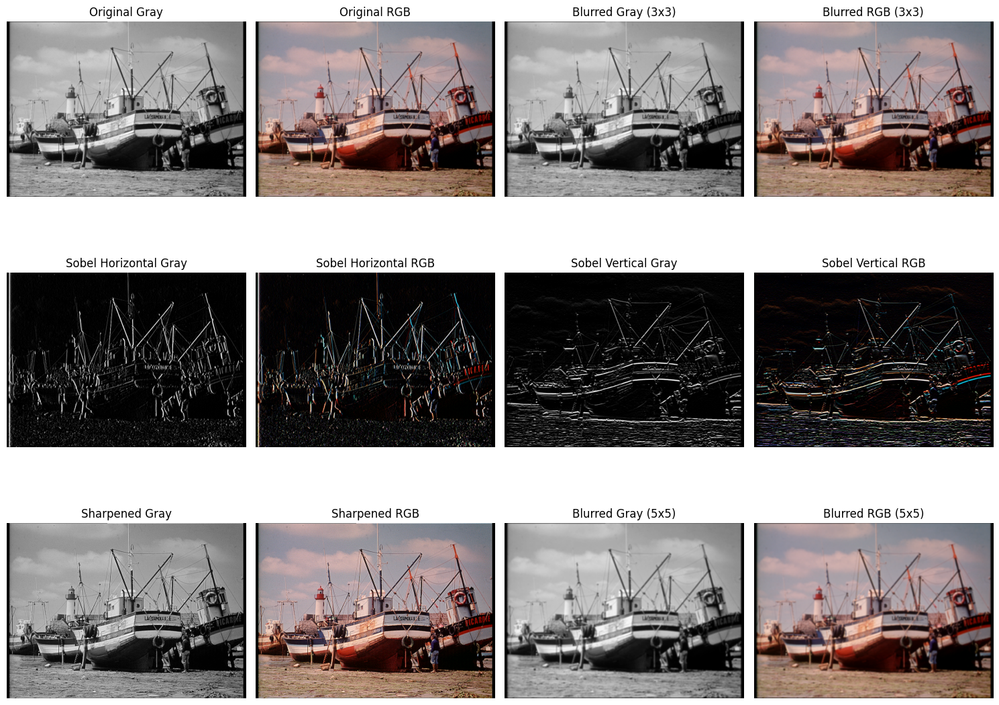

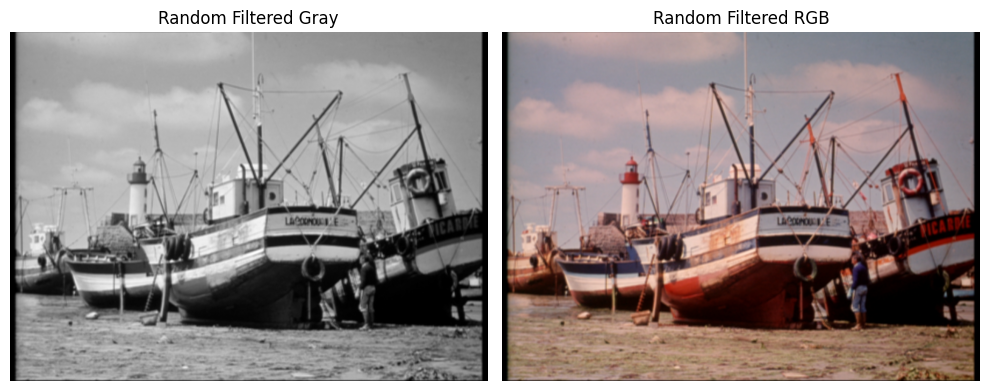

In [ ]:


import matplotlib.pyplot as plt
if __name__ == "__main__":
    # Ensure you have an image named 'Boats.ppm' uploaded to your Colab session
    image_filename = 'Boats.ppm'
    image_directory = './' # Current directory where the file is uploaded
    image_path = os.path.join(image_directory, image_filename)

    # Check if the uploaded file exists
    if not os.path.exists(image_path):
        print(f"Error: The file '{image_filename}' was not found.")
        print("Please upload 'Boats.ppm' to your Colab session.")
        exit() # Exit if the file is not found

    # Load the image
    try:
        # Attempt to load the image explicitly as color (PPM format is typically color)
        original_image_rgb, type_rgb = image_load(image_path, channel=3)

        # If you also need a grayscale version for comparison/processing:
        # Load as grayscale, but keep the RGB load as the primary one based on PPM
        original_image_gray, type_gray = image_load(image_path, channel=1)


    except (FileNotFoundError, ValueError) as e:
        print(e)
        print(f"Could not load image from {image_path}. Please check the file.")
        exit()

    print(f"Loaded gray image type: {type_gray}")
    print(f"Loaded RGB image type: {type_rgb}")

    # Apply filters
    print("Applying filters...")
    # We will apply filters primarily to the RGB image as it's the loaded format,
    # but can also apply to the gray version if needed for comparison.

    # Grayscale images (using the grayscale version loaded)
    blurred_gray = apply_convolution(original_image_gray, kernel_blur)
    sobel_h_gray = apply_convolution(original_image_gray, kernel_sobel_h)
    sobel_v_gray = apply_convolution(original_image_gray, kernel_sobel_v)
    sharpened_gray = apply_convolution(original_image_gray, kernel_sharpen)
    blurred_5x5_gray = apply_convolution(original_image_gray, kernel_blur_5x5)
    random_filtered_gray = apply_convolution(original_image_gray, kernel_random)

    # RGB images (using the loaded RGB image)
    blurred_rgb = apply_convolution(original_image_rgb, kernel_blur)
    sobel_h_rgb = apply_convolution(original_image_rgb, kernel_sobel_h)
    sobel_v_rgb = apply_convolution(original_image_rgb, kernel_sobel_v)
    sharpened_rgb = apply_convolution(original_image_rgb, kernel_sharpen)
    blurred_5x5_rgb = apply_convolution(original_image_rgb, kernel_blur_5x5)
    random_filtered_rgb = apply_convolution(original_image_rgb, kernel_random)


    # Save results
    output_dir = 'filtered_images_boats' # Using a different directory to avoid conflicts
    os.makedirs(output_dir, exist_ok=True)

    cv2.imwrite(os.path.join(output_dir, 'boats_blurred_gray.jpg'), blurred_gray)
    cv2.imwrite(os.path.join(output_dir, 'boats_sobel_h_gray.jpg'), sobel_h_gray)
    cv2.imwrite(os.path.join(output_dir, 'boats_sobel_v_gray.jpg'), sobel_v_gray)
    cv2.imwrite(os.path.join(output_dir, 'boats_sharpened_gray.jpg'), sharpened_gray)
    cv2.imwrite(os.path.join(output_dir, 'boats_blurred_5x5_gray.jpg'), blurred_5x5_gray)
    cv2.imwrite(os.path.join(output_dir, 'boats_random_filtered_gray.jpg'), random_filtered_gray)

    # For RGB images, OpenCV saves in BGR, so convert back before saving
    cv2.imwrite(os.path.join(output_dir, 'boats_blurred_rgb.jpg'), cv2.cvtColor(blurred_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'boats_sobel_h_rgb.jpg'), cv2.cvtColor(sobel_h_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'boats_sobel_v_rgb.jpg'), cv2.cvtColor(sobel_v_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'boats_sharpened_rgb.jpg'), cv2.cvtColor(sharpened_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'boats_blurred_5x5_rgb.jpg'), cv2.cvtColor(blurred_5x5_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'boats_random_filtered_rgb.jpg'), cv2.cvtColor(random_filtered_rgb, cv2.COLOR_RGB2BGR))

    print(f"Filtered images saved to '{output_dir}' directory.")


    # Display results
    print("Displaying results...")
    fig, axes = plt.subplots(3, 4, figsize=(15, 12))
    ax = axes.ravel()

    # Original Images
    # Display the grayscale version
    ax[0].imshow(original_image_gray, cmap='gray')
    ax[0].set_title('Original Gray')
    ax[0].axis('off')

    # Display the RGB version
    ax[1].imshow(original_image_rgb)
    ax[1].set_title('Original RGB')
    ax[1].axis('off')

    # Blurred Images
    ax[2].imshow(blurred_gray, cmap='gray')
    ax[2].set_title('Blurred Gray (3x3)')
    ax[2].axis('off')

    ax[3].imshow(blurred_rgb)
    ax[3].set_title('Blurred RGB (3x3)')
    ax[3].axis('off')

    # Sobel Horizontal
    ax[4].imshow(sobel_h_gray, cmap='gray')
    ax[4].set_title('Sobel Horizontal Gray')
    ax[4].axis('off')

    ax[5].imshow(sobel_h_rgb)
    ax[5].set_title('Sobel Horizontal RGB')
    ax[5].axis('off')

    # Sobel Vertical
    ax[6].imshow(sobel_v_gray, cmap='gray')
    ax[6].set_title('Sobel Vertical Gray')
    ax[6].axis('off')

    ax[7].imshow(sobel_v_rgb)
    ax[7].set_title('Sobel Vertical RGB')
    ax[7].axis('off')

    # Sharpened
    ax[8].imshow(sharpened_gray, cmap='gray')
    ax[8].set_title('Sharpened Gray')
    ax[8].axis('off')

    ax[9].imshow(sharpened_rgb)
    ax[9].set_title('Sharpened RGB')
    ax[9].axis('off')

    # 5x5 Blur
    ax[10].imshow(blurred_5x5_gray, cmap='gray')
    ax[10].set_title('Blurred Gray (5x5)')
    ax[10].axis('off')

    ax[11].imshow(blurred_5x5_rgb)
    ax[11].set_title('Blurred RGB (5x5)')
    ax[11].axis('off')

    plt.tight_layout()
    plt.show()

    # Display Random Filtered Images separately if needed
    fig_random, axes_random = plt.subplots(1, 2, figsize=(10, 5))
    axes_random[0].imshow(random_filtered_gray, cmap='gray')
    axes_random[0].set_title('Random Filtered Gray')
    axes_random[0].axis('off')

    axes_random[1].imshow(random_filtered_rgb)
    axes_random[1].set_title('Random Filtered RGB')
    axes_random[1].axis('off')

    plt.tight_layout()
    plt.show()


Loaded gray image type: gray
Loaded RGB image type: rgb
Applying filters...
Filtered images saved to 'filtered_images_baboon' directory.
Displaying results...


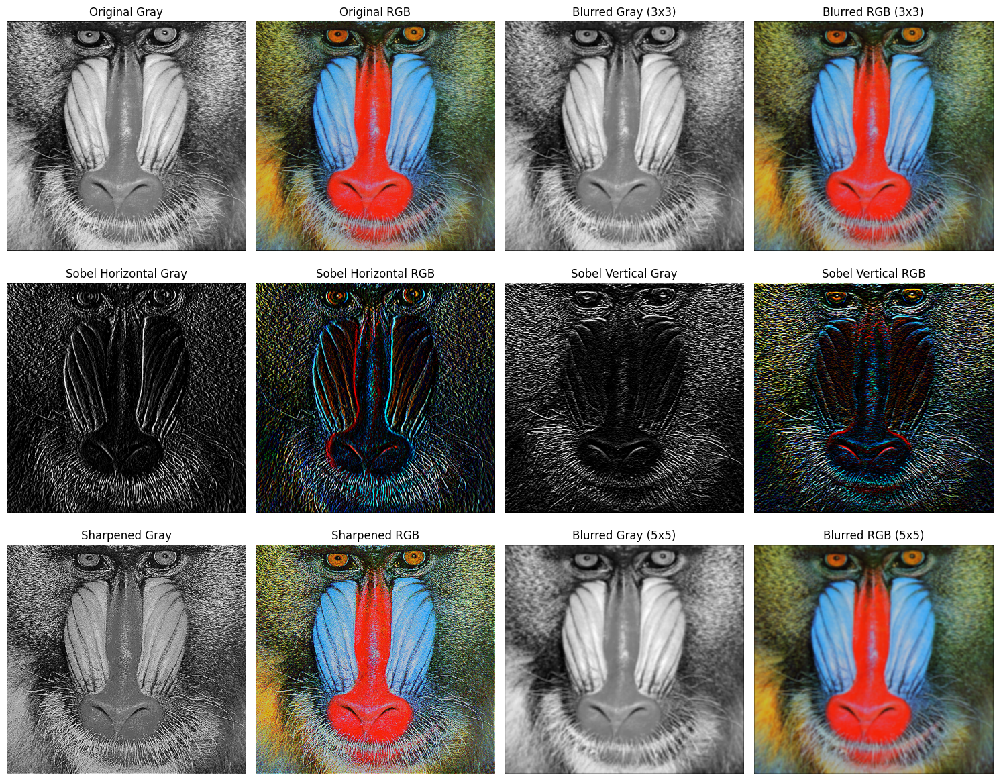

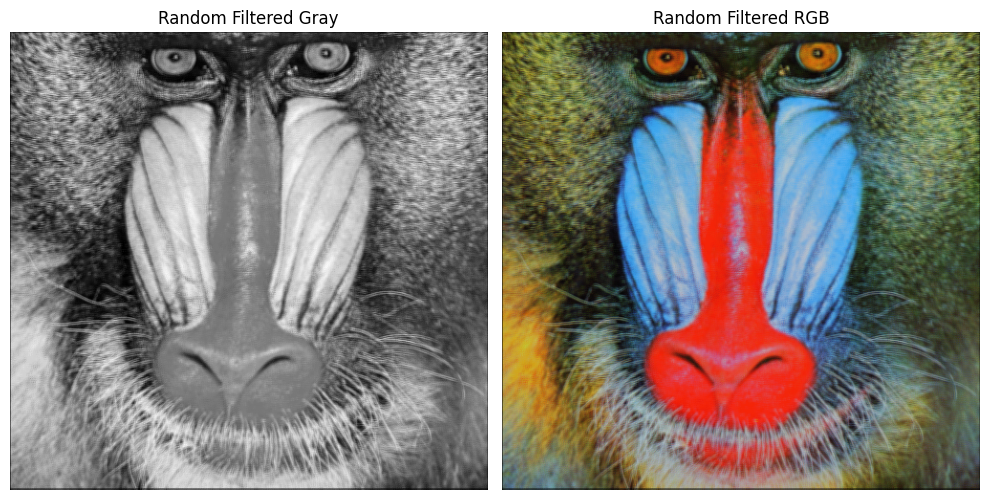

In [ ]:


import matplotlib.pyplot as plt
if __name__ == "__main__":
    # Ensure you have an image named 'baboon.ppm' uploaded to your Colab session
    image_filename = 'baboon.ppm'
    image_directory = './' # Current directory where the file is uploaded
    image_path = os.path.join(image_directory, image_filename)

    # Check if the uploaded file exists
    if not os.path.exists(image_path):
        print(f"Error: The file '{image_filename}' was not found.")
        print("Please upload 'baboon.ppm' to your Colab session.")
        exit() # Exit if the file is not found

    # Load the image
    try:
        # Attempt to load the image explicitly as color (PPM format is typically color)
        original_image_rgb, type_rgb = image_load(image_path, channel=3)

        # If you also need a grayscale version for comparison/processing:
        # Load as grayscale, but keep the RGB load as the primary one based on PPM
        original_image_gray, type_gray = image_load(image_path, channel=1)


    except (FileNotFoundError, ValueError) as e:
        print(e)
        print(f"Could not load image from {image_path}. Please check the file.")
        exit()

    print(f"Loaded gray image type: {type_gray}")
    print(f"Loaded RGB image type: {type_rgb}")

    # Apply filters
    print("Applying filters...")
    # We will apply filters primarily to the RGB image as it's the loaded format,
    # but can also apply to the gray version if needed for comparison.

    # Grayscale images (using the grayscale version loaded)
    blurred_gray = apply_convolution(original_image_gray, kernel_blur)
    sobel_h_gray = apply_convolution(original_image_gray, kernel_sobel_h)
    sobel_v_gray = apply_convolution(original_image_gray, kernel_sobel_v)
    sharpened_gray = apply_convolution(original_image_gray, kernel_sharpen)
    blurred_5x5_gray = apply_convolution(original_image_gray, kernel_blur_5x5)
    random_filtered_gray = apply_convolution(original_image_gray, kernel_random)

    # RGB images (using the loaded RGB image)
    blurred_rgb = apply_convolution(original_image_rgb, kernel_blur)
    sobel_h_rgb = apply_convolution(original_image_rgb, kernel_sobel_h)
    sobel_v_rgb = apply_convolution(original_image_rgb, kernel_sobel_v)
    sharpened_rgb = apply_convolution(original_image_rgb, kernel_sharpen)
    blurred_5x5_rgb = apply_convolution(original_image_rgb, kernel_blur_5x5)
    random_filtered_rgb = apply_convolution(original_image_rgb, kernel_random)


    # Save results
    output_dir = 'filtered_images_baboon' # Using a different directory to avoid conflicts
    os.makedirs(output_dir, exist_ok=True)

    cv2.imwrite(os.path.join(output_dir, 'baboon_blurred_gray.jpg'), blurred_gray)
    cv2.imwrite(os.path.join(output_dir, 'baboon_sobel_h_gray.jpg'), sobel_h_gray)
    cv2.imwrite(os.path.join(output_dir, 'baboon_sobel_v_gray.jpg'), sobel_v_gray)
    cv2.imwrite(os.path.join(output_dir, 'baboon_sharpened_gray.jpg'), sharpened_gray)
    cv2.imwrite(os.path.join(output_dir, 'baboon_blurred_5x5_gray.jpg'), blurred_5x5_gray)
    cv2.imwrite(os.path.join(output_dir, 'baboon_random_filtered_gray.jpg'), random_filtered_gray)

    # For RGB images, OpenCV saves in BGR, so convert back before saving
    cv2.imwrite(os.path.join(output_dir, 'baboon_blurred_rgb.jpg'), cv2.cvtColor(blurred_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'baboon_sobel_h_rgb.jpg'), cv2.cvtColor(sobel_h_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'baboon_sobel_v_rgb.jpg'), cv2.cvtColor(sobel_v_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'baboon_sharpened_rgb.jpg'), cv2.cvtColor(sharpened_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'baboon_blurred_5x5_rgb.jpg'), cv2.cvtColor(blurred_5x5_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'baboon_random_filtered_rgb.jpg'), cv2.cvtColor(random_filtered_rgb, cv2.COLOR_RGB2BGR))

    print(f"Filtered images saved to '{output_dir}' directory.")


    # Display results
    print("Displaying results...")
    fig, axes = plt.subplots(3, 4, figsize=(15, 12))
    ax = axes.ravel()

    # Original Images
    # Display the grayscale version
    ax[0].imshow(original_image_gray, cmap='gray')
    ax[0].set_title('Original Gray')
    ax[0].axis('off')

    # Display the RGB version
    ax[1].imshow(original_image_rgb)
    ax[1].set_title('Original RGB')
    ax[1].axis('off')

    # Blurred Images
    ax[2].imshow(blurred_gray, cmap='gray')
    ax[2].set_title('Blurred Gray (3x3)')
    ax[2].axis('off')

    ax[3].imshow(blurred_rgb)
    ax[3].set_title('Blurred RGB (3x3)')
    ax[3].axis('off')

    # Sobel Horizontal
    ax[4].imshow(sobel_h_gray, cmap='gray')
    ax[4].set_title('Sobel Horizontal Gray')
    ax[4].axis('off')

    ax[5].imshow(sobel_h_rgb)
    ax[5].set_title('Sobel Horizontal RGB')
    ax[5].axis('off')

    # Sobel Vertical
    ax[6].imshow(sobel_v_gray, cmap='gray')
    ax[6].set_title('Sobel Vertical Gray')
    ax[6].axis('off')

    ax[7].imshow(sobel_v_rgb)
    ax[7].set_title('Sobel Vertical RGB')
    ax[7].axis('off')

    # Sharpened
    ax[8].imshow(sharpened_gray, cmap='gray')
    ax[8].set_title('Sharpened Gray')
    ax[8].axis('off')

    ax[9].imshow(sharpened_rgb)
    ax[9].set_title('Sharpened RGB')
    ax[9].axis('off')

    # 5x5 Blur
    ax[10].imshow(blurred_5x5_gray, cmap='gray')
    ax[10].set_title('Blurred Gray (5x5)')
    ax[10].axis('off')

    ax[11].imshow(blurred_5x5_rgb)
    ax[11].set_title('Blurred RGB (5x5)')
    ax[11].axis('off')

    plt.tight_layout()
    plt.show()

    # Display Random Filtered Images separately if needed
    fig_random, axes_random = plt.subplots(1, 2, figsize=(10, 5))
    axes_random[0].imshow(random_filtered_gray, cmap='gray')
    axes_random[0].set_title('Random Filtered Gray')
    axes_random[0].axis('off')

    axes_random[1].imshow(random_filtered_rgb)
    axes_random[1].set_title('Random Filtered RGB')
    axes_random[1].axis('off')

    plt.tight_layout()
    plt.show()


Loaded gray image type: gray
Loaded RGB image type: rgb
Applying filters...
Filtered images saved to 'filtered_images_airplane' directory.
Displaying results...


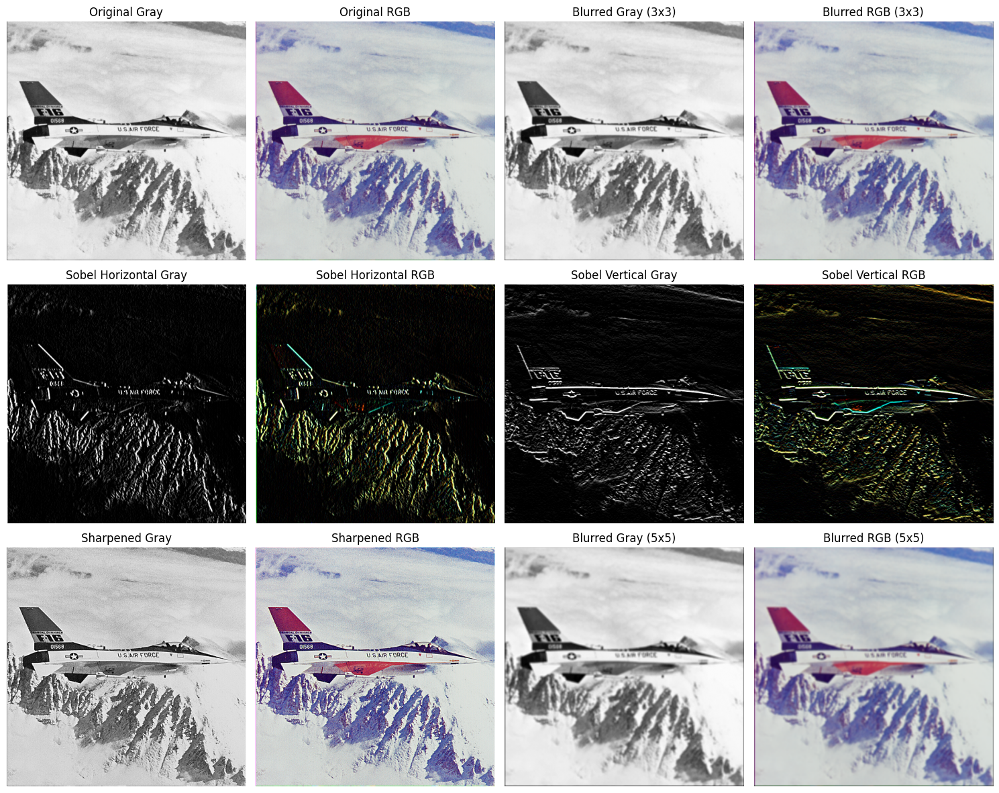

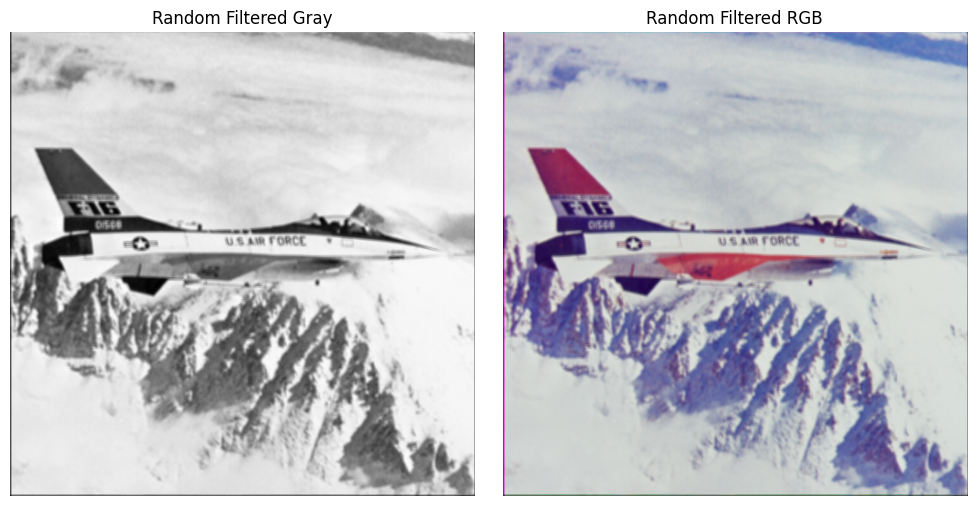

In [ ]:


import matplotlib.pyplot as plt
# Main execution block
if __name__ == "__main__":
    # Ensure you have an image named 'airplane.ppm' uploaded to your Colab session
    image_filename = 'airplane.ppm'
    image_directory = './' # Current directory where the file is uploaded
    image_path = os.path.join(image_directory, image_filename)

    # Check if the uploaded file exists
    if not os.path.exists(image_path):
        print(f"Error: The file '{image_filename}' was not found.")
        print("Please upload 'airplane.ppm' to your Colab session.")
        exit() # Exit if the file is not found

    # Load the image
    try:
        # Attempt to load the image explicitly as color (PPM format is typically color)
        original_image_rgb, type_rgb = image_load(image_path, channel=3)

        # If you also need a grayscale version for comparison/processing:
        # Load as grayscale, but keep the RGB load as the primary one based on PPM
        original_image_gray, type_gray = image_load(image_path, channel=1)


    except (FileNotFoundError, ValueError) as e:
        print(e)
        print(f"Could not load image from {image_path}. Please check the file.")
        exit()

    print(f"Loaded gray image type: {type_gray}")
    print(f"Loaded RGB image type: {type_rgb}")

    # Apply filters
    print("Applying filters...")
    # We will apply filters primarily to the RGB image as it's the loaded format,
    # but can also apply to the gray version if needed for comparison.

    # Grayscale images (using the grayscale version loaded)
    blurred_gray = apply_convolution(original_image_gray, kernel_blur)
    sobel_h_gray = apply_convolution(original_image_gray, kernel_sobel_h)
    sobel_v_gray = apply_convolution(original_image_gray, kernel_sobel_v)
    sharpened_gray = apply_convolution(original_image_gray, kernel_sharpen)
    blurred_5x5_gray = apply_convolution(original_image_gray, kernel_blur_5x5)
    random_filtered_gray = apply_convolution(original_image_gray, kernel_random)

    # RGB images (using the loaded RGB image)
    blurred_rgb = apply_convolution(original_image_rgb, kernel_blur)
    sobel_h_rgb = apply_convolution(original_image_rgb, kernel_sobel_h)
    sobel_v_rgb = apply_convolution(original_image_rgb, kernel_sobel_v)
    sharpened_rgb = apply_convolution(original_image_rgb, kernel_sharpen)
    blurred_5x5_rgb = apply_convolution(original_image_rgb, kernel_blur_5x5)
    random_filtered_rgb = apply_convolution(original_image_rgb, kernel_random)


    # Save results
    output_dir = 'filtered_images_airplane' # Using a different directory to avoid conflicts
    os.makedirs(output_dir, exist_ok=True)

    cv2.imwrite(os.path.join(output_dir, 'airplane_blurred_gray.jpg'), blurred_gray)
    cv2.imwrite(os.path.join(output_dir, 'airplane_sobel_h_gray.jpg'), sobel_h_gray)
    cv2.imwrite(os.path.join(output_dir, 'airplane_sobel_v_gray.jpg'), sobel_v_gray)
    cv2.imwrite(os.path.join(output_dir, 'airplane_sharpened_gray.jpg'), sharpened_gray)
    cv2.imwrite(os.path.join(output_dir, 'airplane_blurred_5x5_gray.jpg'), blurred_5x5_gray)
    cv2.imwrite(os.path.join(output_dir, 'airplane_random_filtered_gray.jpg'), random_filtered_gray)

    # For RGB images, OpenCV saves in BGR, so convert back before saving
    cv2.imwrite(os.path.join(output_dir, 'airplane_blurred_rgb.jpg'), cv2.cvtColor(blurred_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'airplane_sobel_h_rgb.jpg'), cv2.cvtColor(sobel_h_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'airplane_sobel_v_rgb.jpg'), cv2.cvtColor(sobel_v_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'airplane_sharpened_rgb.jpg'), cv2.cvtColor(sharpened_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'airplane_blurred_5x5_rgb.jpg'), cv2.cvtColor(blurred_5x5_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'airplane_random_filtered_rgb.jpg'), cv2.cvtColor(random_filtered_rgb, cv2.COLOR_RGB2BGR))

    print(f"Filtered images saved to '{output_dir}' directory.")


    # Display results
    print("Displaying results...")
    fig, axes = plt.subplots(3, 4, figsize=(15, 12))
    ax = axes.ravel()

    # Original Images
    # Display the grayscale version
    ax[0].imshow(original_image_gray, cmap='gray')
    ax[0].set_title('Original Gray')
    ax[0].axis('off')

    # Display the RGB version
    ax[1].imshow(original_image_rgb)
    ax[1].set_title('Original RGB')
    ax[1].axis('off')

    # Blurred Images
    ax[2].imshow(blurred_gray, cmap='gray')
    ax[2].set_title('Blurred Gray (3x3)')
    ax[2].axis('off')

    ax[3].imshow(blurred_rgb)
    ax[3].set_title('Blurred RGB (3x3)')
    ax[3].axis('off')

    # Sobel Horizontal
    ax[4].imshow(sobel_h_gray, cmap='gray')
    ax[4].set_title('Sobel Horizontal Gray')
    ax[4].axis('off')

    ax[5].imshow(sobel_h_rgb)
    ax[5].set_title('Sobel Horizontal RGB')
    ax[5].axis('off')

    # Sobel Vertical
    ax[6].imshow(sobel_v_gray, cmap='gray')
    ax[6].set_title('Sobel Vertical Gray')
    ax[6].axis('off')

    ax[7].imshow(sobel_v_rgb)
    ax[7].set_title('Sobel Vertical RGB')
    ax[7].axis('off')

    # Sharpened
    ax[8].imshow(sharpened_gray, cmap='gray')
    ax[8].set_title('Sharpened Gray')
    ax[8].axis('off')

    ax[9].imshow(sharpened_rgb)
    ax[9].set_title('Sharpened RGB')
    ax[9].axis('off')

    # 5x5 Blur
    ax[10].imshow(blurred_5x5_gray, cmap='gray')
    ax[10].set_title('Blurred Gray (5x5)')
    ax[10].axis('off')

    ax[11].imshow(blurred_5x5_rgb)
    ax[11].set_title('Blurred RGB (5x5)')
    ax[11].axis('off')

    plt.tight_layout()
    plt.show()

    # Display Random Filtered Images separately if needed
    fig_random, axes_random = plt.subplots(1, 2, figsize=(10, 5))
    axes_random[0].imshow(random_filtered_gray, cmap='gray')
    axes_random[0].set_title('Random Filtered Gray')
    axes_random[0].axis('off')

    axes_random[1].imshow(random_filtered_rgb)
    axes_random[1].set_title('Random Filtered RGB')
    axes_random[1].axis('off')

    plt.tight_layout()
    plt.show()


Loaded gray image type: gray
Loaded RGB image type: rgb
Applying filters...
Filtered images saved to 'filtered_images_barbara' directory.
Displaying results...


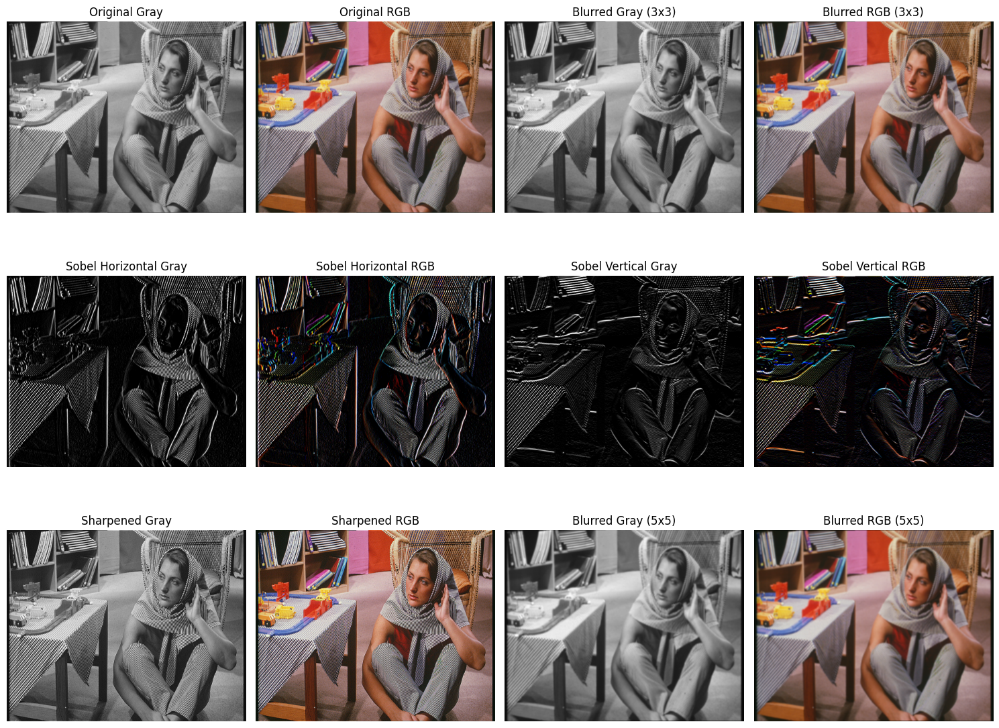

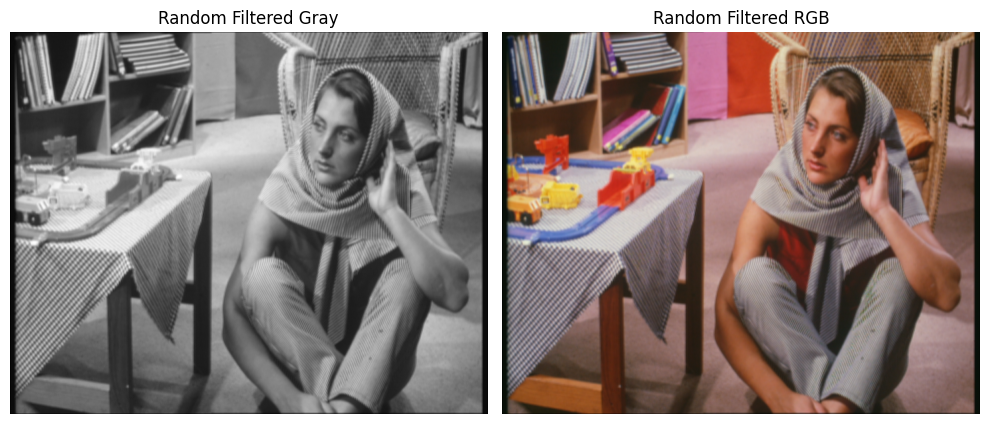

In [ ]:


import matplotlib.pyplot as plt
if __name__ == "__main__":
    # Ensure you have an image named 'barbara.ppm' uploaded to your Colab session
    image_filename = 'barbara.ppm'
    image_directory = './' # Current directory where the file is uploaded
    image_path = os.path.join(image_directory, image_filename)

    # Check if the uploaded file exists
    if not os.path.exists(image_path):
        print(f"Error: The file '{image_filename}' was not found.")
        print("Please upload 'barbara.ppm' to your Colab session.")
        exit() # Exit if the file is not found

    # Load the image
    try:
        # Attempt to load the image explicitly as color (PPM format is typically color)
        original_image_rgb, type_rgb = image_load(image_path, channel=3)

        # If you also need a grayscale version for comparison/processing:
        # Load as grayscale, but keep the RGB load as the primary one based on PPM
        original_image_gray, type_gray = image_load(image_path, channel=1)


    except (FileNotFoundError, ValueError) as e:
        print(e)
        print(f"Could not load image from {image_path}. Please check the file.")
        exit()

    print(f"Loaded gray image type: {type_gray}")
    print(f"Loaded RGB image type: {type_rgb}")

    # Apply filters
    print("Applying filters...")
    # We will apply filters primarily to the RGB image as it's the loaded format,
    # but can also apply to the gray version if needed for comparison.

    # Grayscale images (using the grayscale version loaded)
    blurred_gray = apply_convolution(original_image_gray, kernel_blur)
    sobel_h_gray = apply_convolution(original_image_gray, kernel_sobel_h)
    sobel_v_gray = apply_convolution(original_image_gray, kernel_sobel_v)
    sharpened_gray = apply_convolution(original_image_gray, kernel_sharpen)
    blurred_5x5_gray = apply_convolution(original_image_gray, kernel_blur_5x5)
    random_filtered_gray = apply_convolution(original_image_gray, kernel_random)

    # RGB images (using the loaded RGB image)
    blurred_rgb = apply_convolution(original_image_rgb, kernel_blur)
    sobel_h_rgb = apply_convolution(original_image_rgb, kernel_sobel_h)
    sobel_v_rgb = apply_convolution(original_image_rgb, kernel_sobel_v)
    sharpened_rgb = apply_convolution(original_image_rgb, kernel_sharpen)
    blurred_5x5_rgb = apply_convolution(original_image_rgb, kernel_blur_5x5)
    random_filtered_rgb = apply_convolution(original_image_rgb, kernel_random)


    # Save results
    output_dir = 'filtered_images_barbara' # Using a different directory to avoid conflicts
    os.makedirs(output_dir, exist_ok=True)

    cv2.imwrite(os.path.join(output_dir, 'barbara_blurred_gray.jpg'), blurred_gray)
    cv2.imwrite(os.path.join(output_dir, 'barbara_sobel_h_gray.jpg'), sobel_h_gray)
    cv2.imwrite(os.path.join(output_dir, 'barbara_sobel_v_gray.jpg'), sobel_v_gray)
    cv2.imwrite(os.path.join(output_dir, 'barbara_sharpened_gray.jpg'), sharpened_gray)
    cv2.imwrite(os.path.join(output_dir, 'barbara_blurred_5x5_gray.jpg'), blurred_5x5_gray)
    cv2.imwrite(os.path.join(output_dir, 'barbara_random_filtered_gray.jpg'), random_filtered_gray)

    # For RGB images, OpenCV saves in BGR, so convert back before saving
    cv2.imwrite(os.path.join(output_dir, 'barbara_blurred_rgb.jpg'), cv2.cvtColor(blurred_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'barbara_sobel_h_rgb.jpg'), cv2.cvtColor(sobel_h_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'barbara_sobel_v_rgb.jpg'), cv2.cvtColor(sobel_v_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'barbara_sharpened_rgb.jpg'), cv2.cvtColor(sharpened_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'barbara_blurred_5x5_rgb.jpg'), cv2.cvtColor(blurred_5x5_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'barbara_random_filtered_rgb.jpg'), cv2.cvtColor(random_filtered_rgb, cv2.COLOR_RGB2BGR))

    print(f"Filtered images saved to '{output_dir}' directory.")


    # Display results
    print("Displaying results...")
    fig, axes = plt.subplots(3, 4, figsize=(15, 12))
    ax = axes.ravel()

    # Original Images
    # Display the grayscale version
    ax[0].imshow(original_image_gray, cmap='gray')
    ax[0].set_title('Original Gray')
    ax[0].axis('off')

    # Display the RGB version
    ax[1].imshow(original_image_rgb)
    ax[1].set_title('Original RGB')
    ax[1].axis('off')

    # Blurred Images
    ax[2].imshow(blurred_gray, cmap='gray')
    ax[2].set_title('Blurred Gray (3x3)')
    ax[2].axis('off')

    ax[3].imshow(blurred_rgb)
    ax[3].set_title('Blurred RGB (3x3)')
    ax[3].axis('off')

    # Sobel Horizontal
    ax[4].imshow(sobel_h_gray, cmap='gray')
    ax[4].set_title('Sobel Horizontal Gray')
    ax[4].axis('off')

    ax[5].imshow(sobel_h_rgb)
    ax[5].set_title('Sobel Horizontal RGB')
    ax[5].axis('off')

    # Sobel Vertical
    ax[6].imshow(sobel_v_gray, cmap='gray')
    ax[6].set_title('Sobel Vertical Gray')
    ax[6].axis('off')

    ax[7].imshow(sobel_v_rgb)
    ax[7].set_title('Sobel Vertical RGB')
    ax[7].axis('off')

    # Sharpened
    ax[8].imshow(sharpened_gray, cmap='gray')
    ax[8].set_title('Sharpened Gray')
    ax[8].axis('off')

    ax[9].imshow(sharpened_rgb)
    ax[9].set_title('Sharpened RGB')
    ax[9].axis('off')

    # 5x5 Blur
    ax[10].imshow(blurred_5x5_gray, cmap='gray')
    ax[10].set_title('Blurred Gray (5x5)')
    ax[10].axis('off')

    ax[11].imshow(blurred_5x5_rgb)
    ax[11].set_title('Blurred RGB (5x5)')
    ax[11].axis('off')

    plt.tight_layout()
    plt.show()

    # Display Random Filtered Images separately if needed
    fig_random, axes_random = plt.subplots(1, 2, figsize=(10, 5))
    axes_random[0].imshow(random_filtered_gray, cmap='gray')
    axes_random[0].set_title('Random Filtered Gray')
    axes_random[0].axis('off')

    axes_random[1].imshow(random_filtered_rgb)
    axes_random[1].set_title('Random Filtered RGB')
    axes_random[1].axis('off')

    plt.tight_layout()
    plt.show()


Loaded gray image type: gray
Loaded RGB image type: rgb
Applying filters...
Filtered images saved to 'filtered_images_goldhill' directory.
Displaying results...


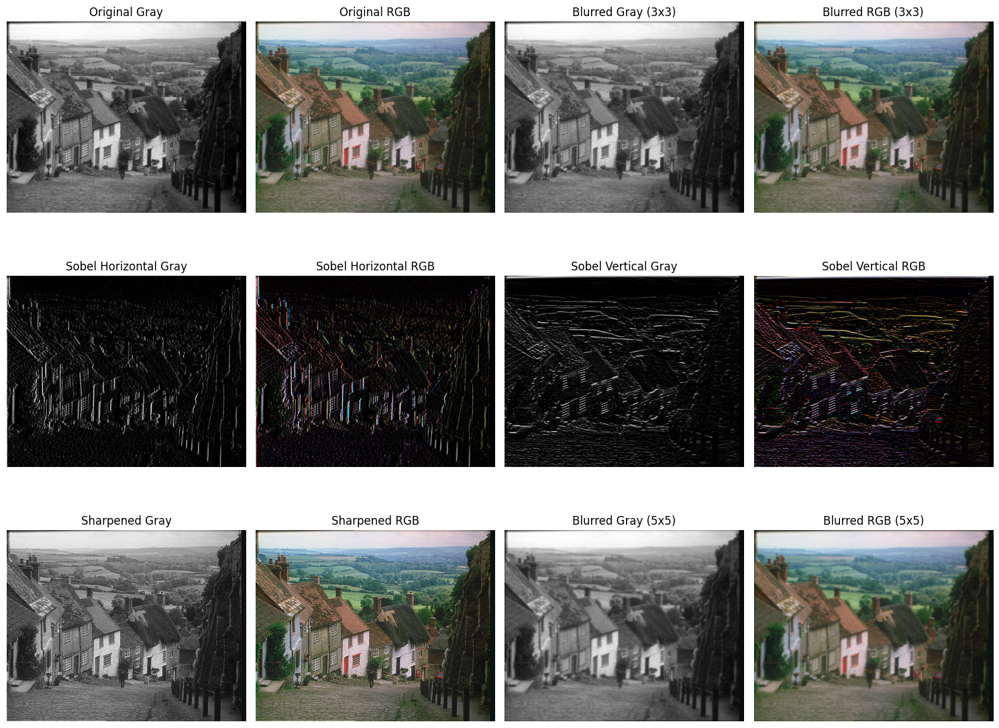

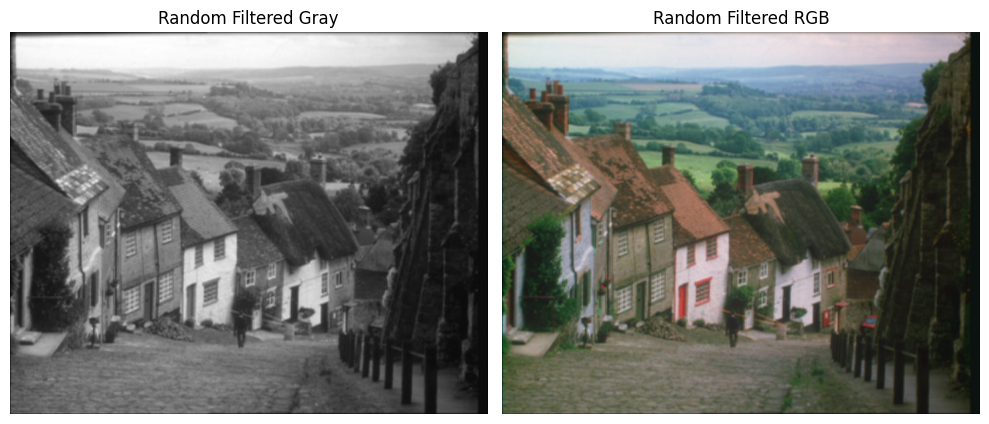

In [ ]:


import matplotlib.pyplot as plt
if __name__ == "__main__":
    # Ensure you have an image named 'goldhill.ppm' uploaded to your Colab session
    image_filename = 'goldhill.ppm'
    image_directory = './' # Current directory where the file is uploaded
    image_path = os.path.join(image_directory, image_filename)

    # Check if the uploaded file exists
    if not os.path.exists(image_path):
        print(f"Error: The file '{image_filename}' was not found.")
        print("Please upload 'goldhill.ppm' to your Colab session.")
        exit() # Exit if the file is not found

    # Load the image
    try:
        # Attempt to load the image explicitly as color (PPM format is typically color)
        original_image_rgb, type_rgb = image_load(image_path, channel=3)

        # If you also need a grayscale version for comparison/processing:
        # Load as grayscale, but keep the RGB load as the primary one based on PPM
        original_image_gray, type_gray = image_load(image_path, channel=1)


    except (FileNotFoundError, ValueError) as e:
        print(e)
        print(f"Could not load image from {image_path}. Please check the file.")
        exit()

    print(f"Loaded gray image type: {type_gray}")
    print(f"Loaded RGB image type: {type_rgb}")

    # Apply filters
    print("Applying filters...")
    # We will apply filters primarily to the RGB image as it's the loaded format,
    # but can also apply to the gray version if needed for comparison.

    # Grayscale images (using the grayscale version loaded)
    blurred_gray = apply_convolution(original_image_gray, kernel_blur)
    sobel_h_gray = apply_convolution(original_image_gray, kernel_sobel_h)
    sobel_v_gray = apply_convolution(original_image_gray, kernel_sobel_v)
    sharpened_gray = apply_convolution(original_image_gray, kernel_sharpen)
    blurred_5x5_gray = apply_convolution(original_image_gray, kernel_blur_5x5)
    random_filtered_gray = apply_convolution(original_image_gray, kernel_random)

    # RGB images (using the loaded RGB image)
    blurred_rgb = apply_convolution(original_image_rgb, kernel_blur)
    sobel_h_rgb = apply_convolution(original_image_rgb, kernel_sobel_h)
    sobel_v_rgb = apply_convolution(original_image_rgb, kernel_sobel_v)
    sharpened_rgb = apply_convolution(original_image_rgb, kernel_sharpen)
    blurred_5x5_rgb = apply_convolution(original_image_rgb, kernel_blur_5x5)
    random_filtered_rgb = apply_convolution(original_image_rgb, kernel_random)


    # Save results
    output_dir = 'filtered_images_goldhill' # Using a different directory to avoid conflicts
    os.makedirs(output_dir, exist_ok=True)

    cv2.imwrite(os.path.join(output_dir, 'goldhill_blurred_gray.jpg'), blurred_gray)
    cv2.imwrite(os.path.join(output_dir, 'goldhill_sobel_h_gray.jpg'), sobel_h_gray)
    cv2.imwrite(os.path.join(output_dir, 'goldhill_sobel_v_gray.jpg'), sobel_v_gray)
    cv2.imwrite(os.path.join(output_dir, 'goldhill_sharpened_gray.jpg'), sharpened_gray)
    cv2.imwrite(os.path.join(output_dir, 'goldhill_blurred_5x5_gray.jpg'), blurred_5x5_gray)
    cv2.imwrite(os.path.join(output_dir, 'goldhill_random_filtered_gray.jpg'), random_filtered_gray)

    # For RGB images, OpenCV saves in BGR, so convert back before saving
    cv2.imwrite(os.path.join(output_dir, 'goldhill_blurred_rgb.jpg'), cv2.cvtColor(blurred_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'goldhill_sobel_h_rgb.jpg'), cv2.cvtColor(sobel_h_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'goldhill_sobel_v_rgb.jpg'), cv2.cvtColor(sobel_v_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'goldhill_sharpened_rgb.jpg'), cv2.cvtColor(sharpened_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'goldhill_blurred_5x5_rgb.jpg'), cv2.cvtColor(blurred_5x5_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'goldhill_random_filtered_rgb.jpg'), cv2.cvtColor(random_filtered_rgb, cv2.COLOR_RGB2BGR))

    print(f"Filtered images saved to '{output_dir}' directory.")


    # Display results
    print("Displaying results...")
    fig, axes = plt.subplots(3, 4, figsize=(15, 12))
    ax = axes.ravel()

    # Original Images
    # Display the grayscale version
    ax[0].imshow(original_image_gray, cmap='gray')
    ax[0].set_title('Original Gray')
    ax[0].axis('off')

    # Display the RGB version
    ax[1].imshow(original_image_rgb)
    ax[1].set_title('Original RGB')
    ax[1].axis('off')

    # Blurred Images
    ax[2].imshow(blurred_gray, cmap='gray')
    ax[2].set_title('Blurred Gray (3x3)')
    ax[2].axis('off')

    ax[3].imshow(blurred_rgb)
    ax[3].set_title('Blurred RGB (3x3)')
    ax[3].axis('off')

    # Sobel Horizontal
    ax[4].imshow(sobel_h_gray, cmap='gray')
    ax[4].set_title('Sobel Horizontal Gray')
    ax[4].axis('off')

    ax[5].imshow(sobel_h_rgb)
    ax[5].set_title('Sobel Horizontal RGB')
    ax[5].axis('off')

    # Sobel Vertical
    ax[6].imshow(sobel_v_gray, cmap='gray')
    ax[6].set_title('Sobel Vertical Gray')
    ax[6].axis('off')

    ax[7].imshow(sobel_v_rgb)
    ax[7].set_title('Sobel Vertical RGB')
    ax[7].axis('off')

    # Sharpened
    ax[8].imshow(sharpened_gray, cmap='gray')
    ax[8].set_title('Sharpened Gray')
    ax[8].axis('off')

    ax[9].imshow(sharpened_rgb)
    ax[9].set_title('Sharpened RGB')
    ax[9].axis('off')

    # 5x5 Blur
    ax[10].imshow(blurred_5x5_gray, cmap='gray')
    ax[10].set_title('Blurred Gray (5x5)')
    ax[10].axis('off')

    ax[11].imshow(blurred_5x5_rgb)
    ax[11].set_title('Blurred RGB (5x5)')
    ax[11].axis('off')

    plt.tight_layout()
    plt.show()

    # Display Random Filtered Images separately if needed
    fig_random, axes_random = plt.subplots(1, 2, figsize=(10, 5))
    axes_random[0].imshow(random_filtered_gray, cmap='gray')
    axes_random[0].set_title('Random Filtered Gray')
    axes_random[0].axis('off')

    axes_random[1].imshow(random_filtered_rgb)
    axes_random[1].set_title('Random Filtered RGB')
    axes_random[1].axis('off')

    plt.tight_layout()
    plt.show()


Loaded gray image type: gray
Loaded RGB image type: rgb
Applying filters...
Filtered images saved to 'filtered_images_lenna' directory.
Displaying results...


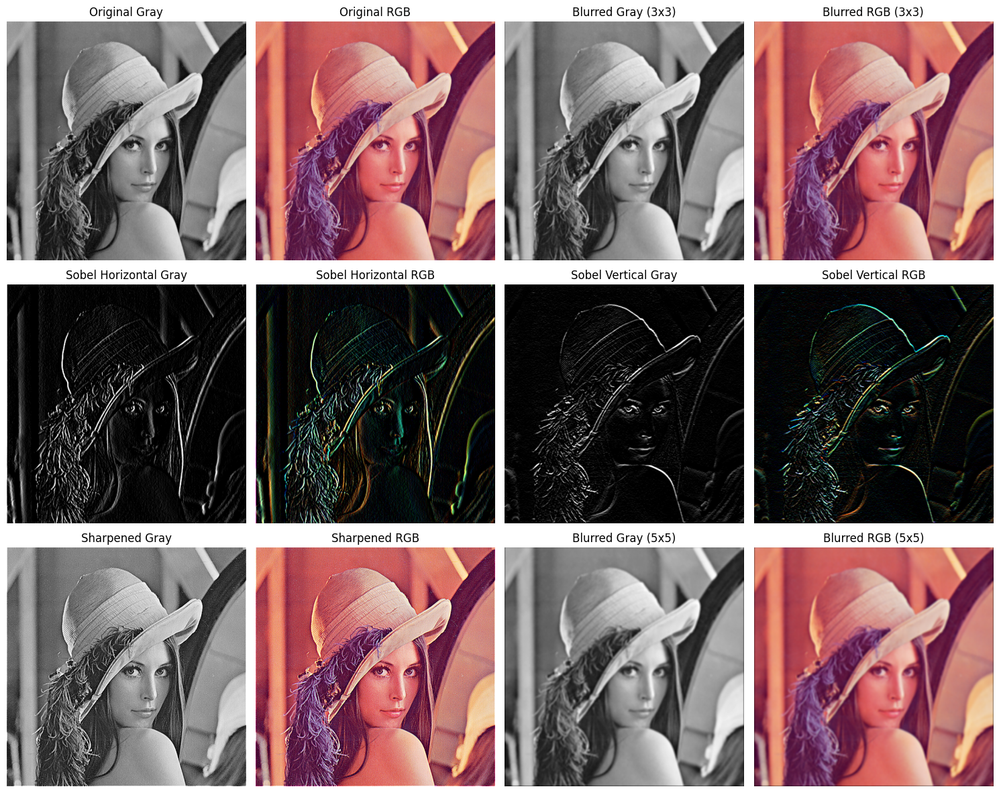

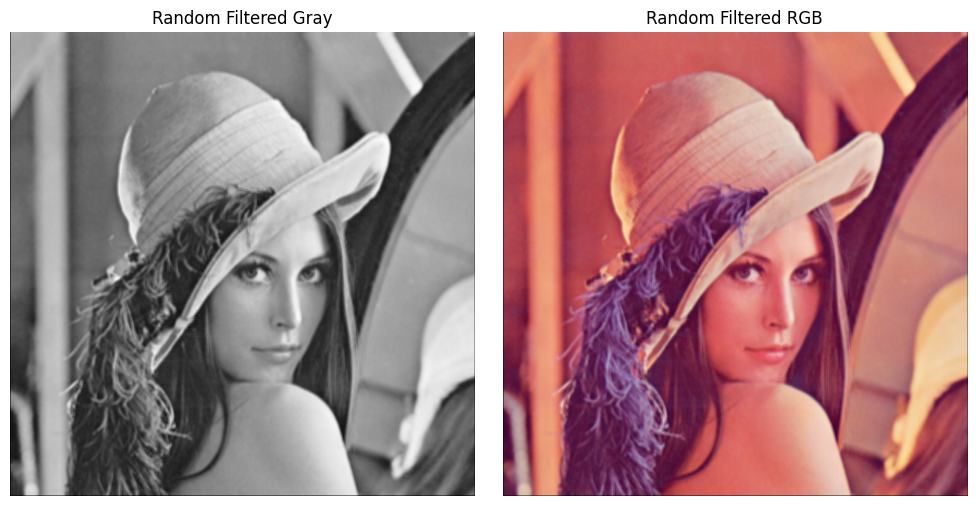

In [ ]:


import matplotlib.pyplot as plt
# Main execution block
if __name__ == "__main__":
    # Ensure you have an image named 'lenna.ppm' uploaded to your Colab session
    image_filename = 'lenna.ppm'
    image_directory = './' # Current directory where the file is uploaded
    image_path = os.path.join(image_directory, image_filename)

    # Check if the uploaded file exists
    if not os.path.exists(image_path):
        print(f"Error: The file '{image_filename}' was not found.")
        print("Please upload 'lenna.ppm' to your Colab session.")
        exit() # Exit if the file is not found

    # Load the image
    try:
        # Attempt to load the image explicitly as color (PPM format is typically color)
        original_image_rgb, type_rgb = image_load(image_path, channel=3)

        # If you also need a grayscale version for comparison/processing:
        # Load as grayscale, but keep the RGB load as the primary one based on PPM
        original_image_gray, type_gray = image_load(image_path, channel=1)


    except (FileNotFoundError, ValueError) as e:
        print(e)
        print(f"Could not load image from {image_path}. Please check the file.")
        exit()

    print(f"Loaded gray image type: {type_gray}")
    print(f"Loaded RGB image type: {type_rgb}")

    # Apply filters
    print("Applying filters...")
    # We will apply filters primarily to the RGB image as it's the loaded format,
    # but can also apply to the gray version if needed for comparison.

    # Grayscale images (using the grayscale version loaded)
    blurred_gray = apply_convolution(original_image_gray, kernel_blur)
    sobel_h_gray = apply_convolution(original_image_gray, kernel_sobel_h)
    sobel_v_gray = apply_convolution(original_image_gray, kernel_sobel_v)
    sharpened_gray = apply_convolution(original_image_gray, kernel_sharpen)
    blurred_5x5_gray = apply_convolution(original_image_gray, kernel_blur_5x5)
    random_filtered_gray = apply_convolution(original_image_gray, kernel_random)

    # RGB images (using the loaded RGB image)
    blurred_rgb = apply_convolution(original_image_rgb, kernel_blur)
    sobel_h_rgb = apply_convolution(original_image_rgb, kernel_sobel_h)
    sobel_v_rgb = apply_convolution(original_image_rgb, kernel_sobel_v)
    sharpened_rgb = apply_convolution(original_image_rgb, kernel_sharpen)
    blurred_5x5_rgb = apply_convolution(original_image_rgb, kernel_blur_5x5)
    random_filtered_rgb = apply_convolution(original_image_rgb, kernel_random)


    # Save results
    output_dir = 'filtered_images_lenna' # Using a different directory to avoid conflicts
    os.makedirs(output_dir, exist_ok=True)

    cv2.imwrite(os.path.join(output_dir, 'lenna_blurred_gray.jpg'), blurred_gray)
    cv2.imwrite(os.path.join(output_dir, 'lenna_sobel_h_gray.jpg'), sobel_h_gray)
    cv2.imwrite(os.path.join(output_dir, 'lenna_sobel_v_gray.jpg'), sobel_v_gray)
    cv2.imwrite(os.path.join(output_dir, 'lenna_sharpened_gray.jpg'), sharpened_gray)
    cv2.imwrite(os.path.join(output_dir, 'lenna_blurred_5x5_gray.jpg'), blurred_5x5_gray)
    cv2.imwrite(os.path.join(output_dir, 'lenna_random_filtered_gray.jpg'), random_filtered_gray)

    # For RGB images, OpenCV saves in BGR, so convert back before saving
    cv2.imwrite(os.path.join(output_dir, 'lenna_blurred_rgb.jpg'), cv2.cvtColor(blurred_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'lenna_sobel_h_rgb.jpg'), cv2.cvtColor(sobel_h_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'lenna_sobel_v_rgb.jpg'), cv2.cvtColor(sobel_v_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'lenna_sharpened_rgb.jpg'), cv2.cvtColor(sharpened_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'lenna_blurred_5x5_rgb.jpg'), cv2.cvtColor(blurred_5x5_rgb, cv2.COLOR_RGB2BGR))
    cv2.imwrite(os.path.join(output_dir, 'lenna_random_filtered_rgb.jpg'), cv2.cvtColor(random_filtered_rgb, cv2.COLOR_RGB2BGR))

    print(f"Filtered images saved to '{output_dir}' directory.")


    # Display results
    print("Displaying results...")
    fig, axes = plt.subplots(3, 4, figsize=(15, 12))
    ax = axes.ravel()

    # Original Images
    # Display the grayscale version
    ax[0].imshow(original_image_gray, cmap='gray')
    ax[0].set_title('Original Gray')
    ax[0].axis('off')

    # Display the RGB version
    ax[1].imshow(original_image_rgb)
    ax[1].set_title('Original RGB')
    ax[1].axis('off')

    # Blurred Images
    ax[2].imshow(blurred_gray, cmap='gray')
    ax[2].set_title('Blurred Gray (3x3)')
    ax[2].axis('off')

    ax[3].imshow(blurred_rgb)
    ax[3].set_title('Blurred RGB (3x3)')
    ax[3].axis('off')

    # Sobel Horizontal
    ax[4].imshow(sobel_h_gray, cmap='gray')
    ax[4].set_title('Sobel Horizontal Gray')
    ax[4].axis('off')

    ax[5].imshow(sobel_h_rgb)
    ax[5].set_title('Sobel Horizontal RGB')
    ax[5].axis('off')

    # Sobel Vertical
    ax[6].imshow(sobel_v_gray, cmap='gray')
    ax[6].set_title('Sobel Vertical Gray')
    ax[6].axis('off')

    ax[7].imshow(sobel_v_rgb)
    ax[7].set_title('Sobel Vertical RGB')
    ax[7].axis('off')

    # Sharpened
    ax[8].imshow(sharpened_gray, cmap='gray')
    ax[8].set_title('Sharpened Gray')
    ax[8].axis('off')

    ax[9].imshow(sharpened_rgb)
    ax[9].set_title('Sharpened RGB')
    ax[9].axis('off')

    # 5x5 Blur
    ax[10].imshow(blurred_5x5_gray, cmap='gray')
    ax[10].set_title('Blurred Gray (5x5)')
    ax[10].axis('off')

    ax[11].imshow(blurred_5x5_rgb)
    ax[11].set_title('Blurred RGB (5x5)')
    ax[11].axis('off')

    plt.tight_layout()
    plt.show()

    # Display Random Filtered Images separately if needed
    fig_random, axes_random = plt.subplots(1, 2, figsize=(10, 5))
    axes_random[0].imshow(random_filtered_gray, cmap='gray')
    axes_random[0].set_title('Random Filtered Gray')
    axes_random[0].axis('off')

    axes_random[1].imshow(random_filtered_rgb)
    axes_random[1].set_title('Random Filtered RGB')
    axes_random[1].axis('off')

    plt.tight_layout()
    plt.show()
